# UMAPs Neurips samples, received list of markers

In this notebook different markers to identify NK cell subpopulations are tested. Markers are collected from R-code and other documentation received from prof. Satu Mustjoki group. RNA and corresponding surface markers are shown when available. Protein expression levels within a cell are normalized using the centered-log ratio (CLR) transformation. UMAPs are generated using latent space representation of measured RNA and surface protein data. 

Markers from R-code:

nk_high_markers = ["FGFBP2", "FCGR3A", "S1PR5", "KLRC1", "KLRC2", "KLRC3", "KLRD1", "GNLY","GZMB", "CX3CR1", "GPR56", "PRF1", "KLRB1", "SPON2", "NKG7", "TTC38", "FCRL6", "LILRB1","PLAC8", "MBP"]

nk_genes2 = ["KLRC1","NCAM1","GZMK","GZMA","KLRB1","KLRC2","GZMH","LAG3","B2M","HLA-DRA","OAS3","MX1","IRF7","MX2","IRF9","OAS1","OAS2", "EIF2AK2", "TNFRSF18", "TNFRSF9",  "TNFRSF4",  "CRTAM", "ENTPD1",  "HAVCR2",  "TIGIT", "TNFSF10", "BCL2L11", "CCL3", "CCL4", "TNF", "IFNG", "CD69"]

nk_genes = ["CD3E", "NCAM1", "GZMK", "SELL", "XCL1", "XCL2", "KLRC1", "IL7R", "LTB", "FCGR3A", "GZMA", "GZMB", "GZMH", "GZMM", "KLRC2", "ZEB2", "KLF2", "PRDM1", "GZMH", "LAG3"]


Markers from ab documentation (weak detection of some of these proteins problematic, could be predicted using the model?) 

- NK immature: NCAM1(CD56)
- NK activating: NCR1(CD335), KLRK1(CD314), CD2, CD226
- NK maturation: B3GAT1 (CD57), 
- NK inhibitory: KIR2DL1 (CD158A), KIR2DL3 (CD158B2), KIR3DL1 (CD158E1)


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
adata_neurips

AnnData object with n_obs × n_vars = 80998 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [4]:
#To find gene names

result = [i for i in adata_neurips.var_names if i.startswith('ROR')]
print(result)

['ROR1', 'ROR2', 'RORA', 'RORA-AS1', 'RORB', 'RORC']


In [5]:
adata_neurips.obs['cell_type'].unique().tolist()

['NK',
 'CD8+ T CD69+ CD45RA+',
 'NK CD158e1+',
 'HSC',
 'CD14+ Mono',
 'B1 B IGKC+',
 'CD4+ T activated',
 'CD8+ T CD69+ CD45RO+',
 'G/M prog',
 'Naive CD20+ B IGKC-',
 'CD8+ T CD49f+',
 'Naive CD20+ B IGKC+',
 'CD4+ T naive',
 'CD8+ T naive',
 'CD4+ T activated integrinB7+',
 'cDC2',
 'gdT TCRVD2+',
 'CD8+ T TIGIT+ CD45RO+',
 'CD16+ Mono',
 'Erythroblast',
 'MAIT',
 'T reg',
 'gdT CD158b+',
 'Transitional B',
 'Proerythroblast',
 'CD8+ T CD57+ CD45RO+',
 'Plasmablast IGKC+',
 'ILC1',
 'Lymph prog',
 'ILC',
 'MK/E prog',
 'Normoblast',
 'CD8+ T CD57+ CD45RA+',
 'pDC',
 'B1 B IGKC-',
 'Plasma cell IGKC-',
 'Plasmablast IGKC-',
 'Plasma cell IGKC+',
 'CD8+ T TIGIT+ CD45RA+',
 'CD8+ T naive CD127+ CD26- CD101-',
 'CD4+ T CD314+ CD45RA+',
 'cDC1',
 'T prog cycling',
 'dnT']

In [6]:
#Both NK cell types selected


neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [7]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [8]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [9]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

In [10]:
samples=adata_neurips.obs['POOL'].unique().tolist()

In [11]:
#selecting one sample from Neurips

eg=adata_neurips[adata_neurips.obs['POOL'] == "s4d1"].copy()


In [12]:
eg

AnnData object with n_obs × n_vars = 4885 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [13]:
prot=eg.obsm['protein_expression_clr_neurips']

In [14]:
prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,HLA-E,CD82,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,1.532575,0.614600,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.283465,0.614600,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,1.344431,0.353792,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.859205,1.527772,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,1.429432,1.031029,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGATCGTCTCTATAC-1-s4d1,0.000000,1.132949,1.358918,1.523729,1.195368,1.312986,1.077960,1.173337,1.690467,1.013739,...,1.482333,0.353792,0.576253,1.157734,1.304730,0.0,0.0,0.0,0.0,0.0
AAGACTCAGGGCAAGG-1-s4d1,0.652674,1.302596,1.208881,0.541080,1.090419,1.589583,1.436578,1.240123,1.379313,0.561056,...,1.149104,0.614600,0.818218,1.189870,1.180752,0.0,0.0,0.0,0.0,0.0
CGAGAAGCACCTCGTT-1-s4d1,0.378666,0.764571,1.208881,0.730824,1.494512,1.944753,2.308527,0.941152,1.342130,1.231042,...,1.184424,0.773465,0.939506,1.017749,1.112478,0.0,0.0,0.0,0.0,0.0
TATCCTAGTTCTCCTG-1-s4d1,0.000000,1.302596,1.286711,0.890243,1.377072,1.150531,0.882414,1.469979,1.649530,0.607664,...,1.401893,1.405442,0.860303,1.124532,1.304730,0.0,0.0,0.0,0.0,0.0


In [15]:
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CX3CR1': 'CX3CR1_prot', 'CD52': 'CD52_prot','CD69': 'CD69_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})


In [16]:
#some proteins and genes have same names, here _prot added after protein names

a = eg.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
eg.obs=adata_eg


In [17]:
#selecting NK cells, gd T cells and ILCs

sample_nk = eg[(eg.obs['cell_type'] == "NK") | (eg.obs['cell_type'] == "NK CD158e1+") | (eg.obs['cell_type'] == "ILC") | (eg.obs['cell_type'] == "gdT CD158b+")].copy()   


In [18]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_neurips, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(adata_neurips)

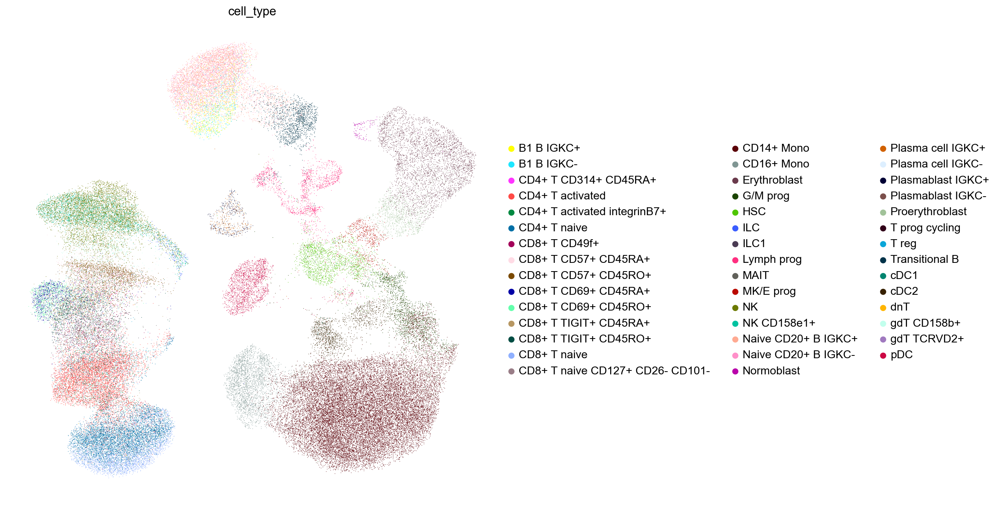

In [19]:
#Whole Neurips dataset, coloured by annotated cell types

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_neurips, color = ['cell_type'], frameon = False)

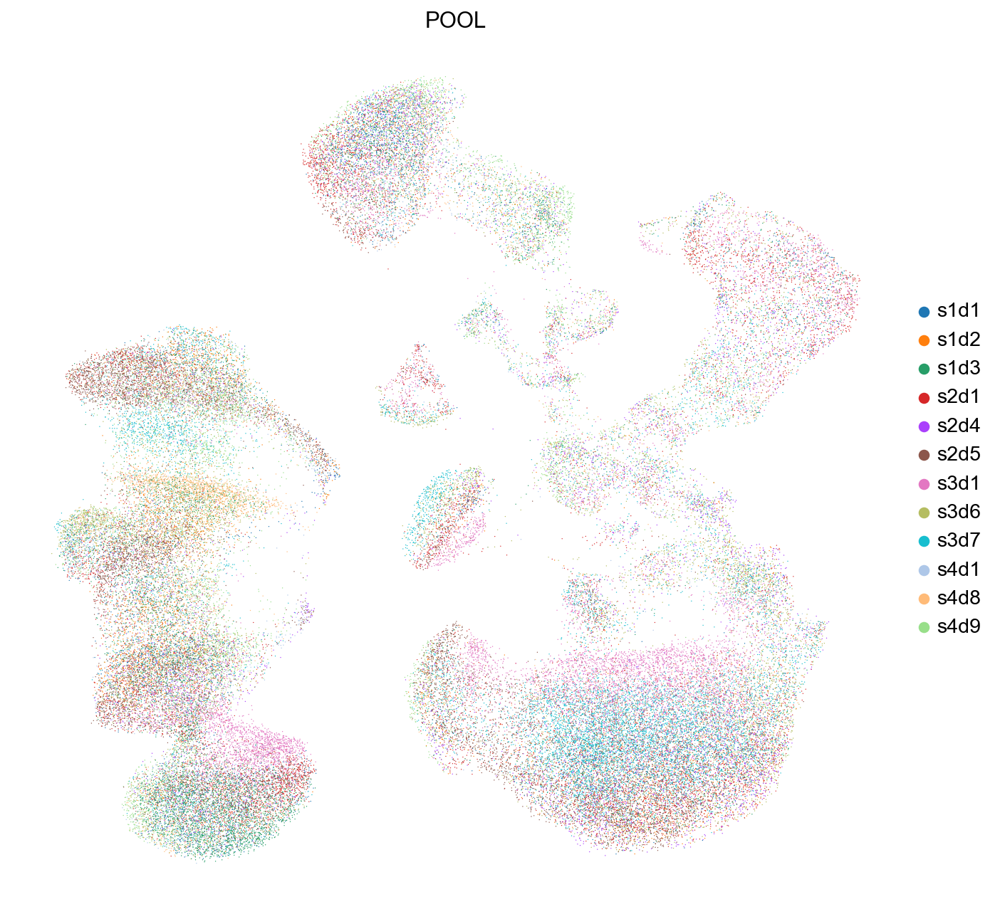

In [20]:
#Whole neurips dataset, coloured by samples

sc.pl.umap(adata_neurips, color = ['POOL'], frameon = False)

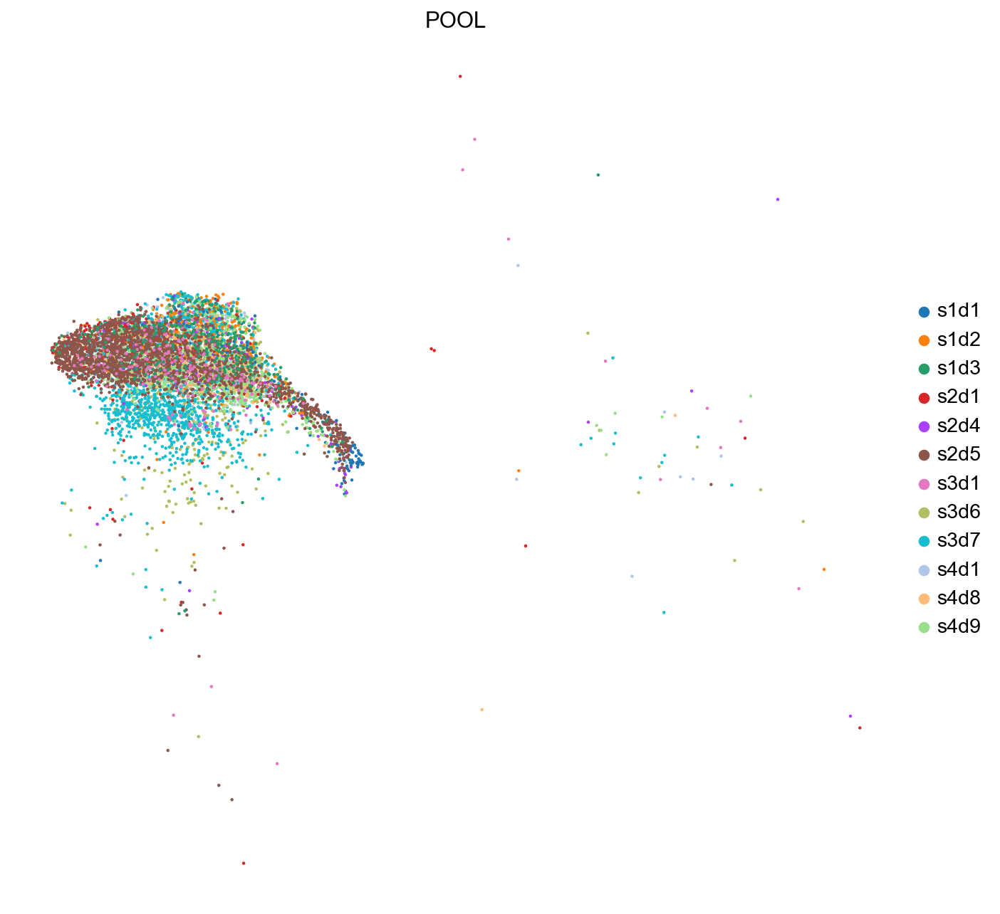

In [21]:
#All samples, but only selected cell types (NK, ILC and gd T cells)

sc.pl.umap(neurips_nk, color = ['POOL'], frameon = False)

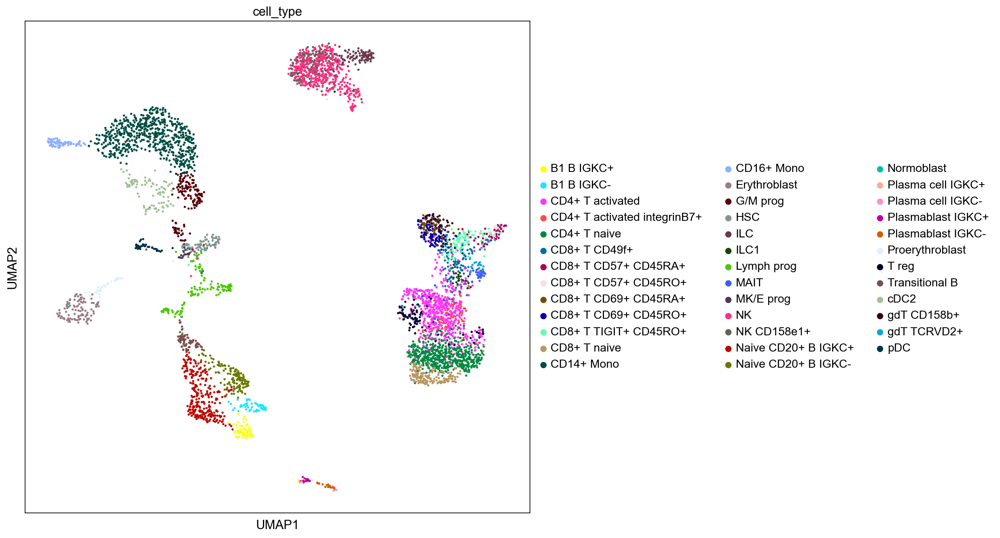

In [22]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

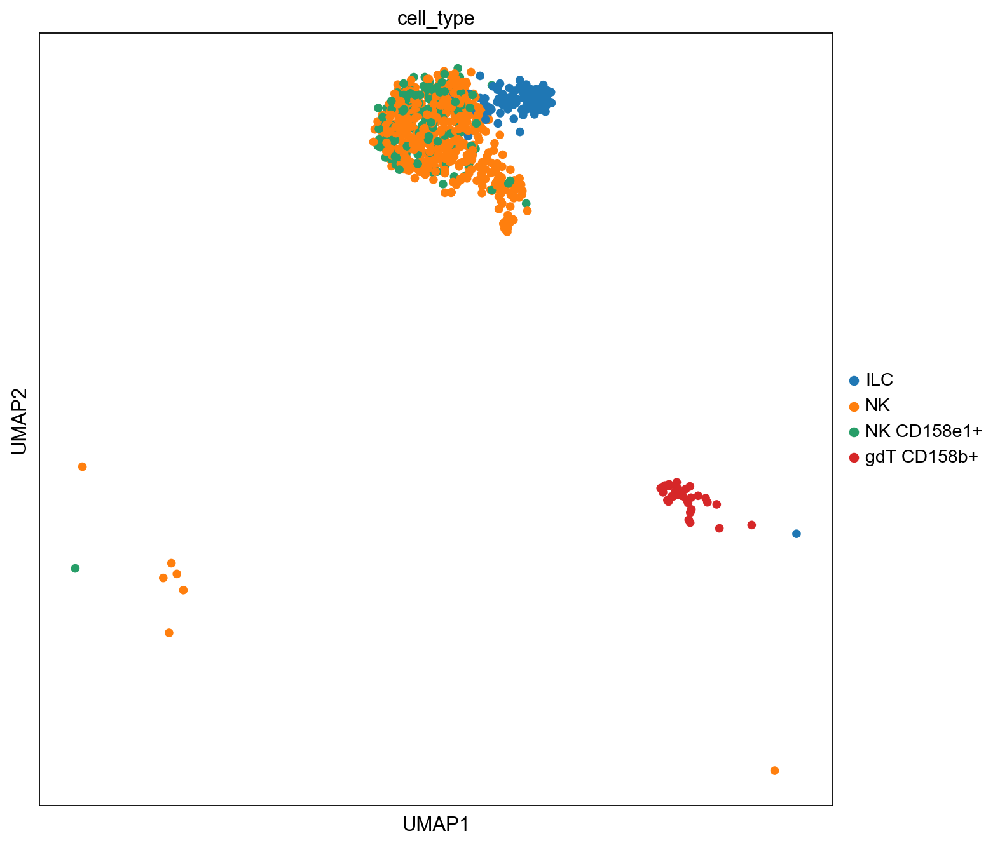

In [23]:
sc.pl.umap(sample_nk, color = ['cell_type'])

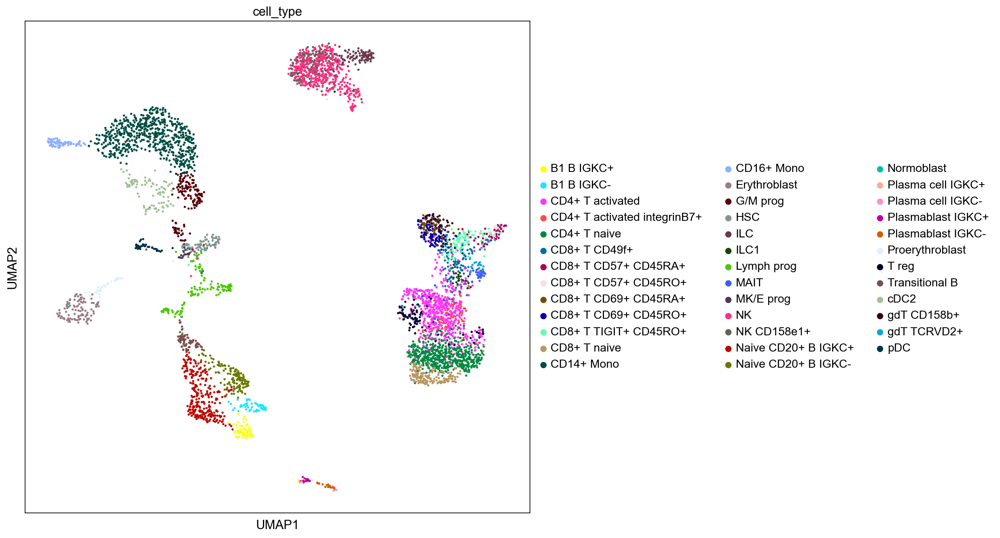

In [24]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

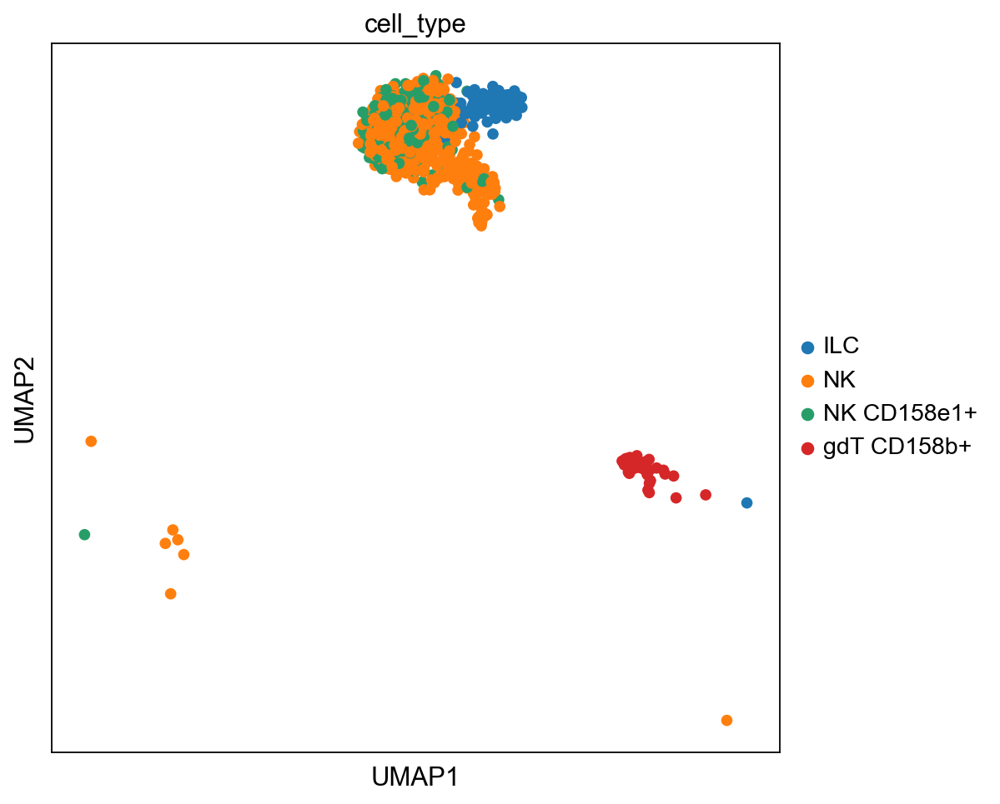

In [25]:
#one sample, only NKs + ILCs

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'])

# 1.  Markers from Olli's list

- NK immature: NCAM1(CD56)
- NK activating: NCR1(CD335), KLRK1(CD314), CD2, CD226
- NK maturation: B3GAT1 (CD57), 
- NK inhibitory: KIR2DL1 (CD158A), KIR2DL3 (CD158B2), KIR3DL1 (CD158E1)

In [52]:
nk_immature = ['NCAM1']
nk_immature_prot = ['CD56']

nk_activating= ['NCR1', 'KLRK1', 'CD2', 'CD226'] 
nk_activating_prot = ['CD335', 'CD314' ]    #CD2 and CD226 not in the panel

nk_maturation= ['B3GAT1']
nk_maturation_prot = ['CD57']

nk_inhibitory= ['KIR2DL1', 'KIR2DL3']  #KIR3DL3 not measured
nk_inhibitory_prot = ['CD158e1']     #CD158A and CD158b2 not included in the panel 

In [33]:
#Used to check which genes were measured

listOfmarkers= ['NCAM1']


for x in listOfmarkers:
    if x in adata_neurips.var_names:
        print(x)


NCAM1


In [39]:
#Used to check which markers were measured

listOfmarkers= ["CD314"]

for x in listOfmarkers:
    if x in prot.columns:
        print(x)


CD314


## Immature

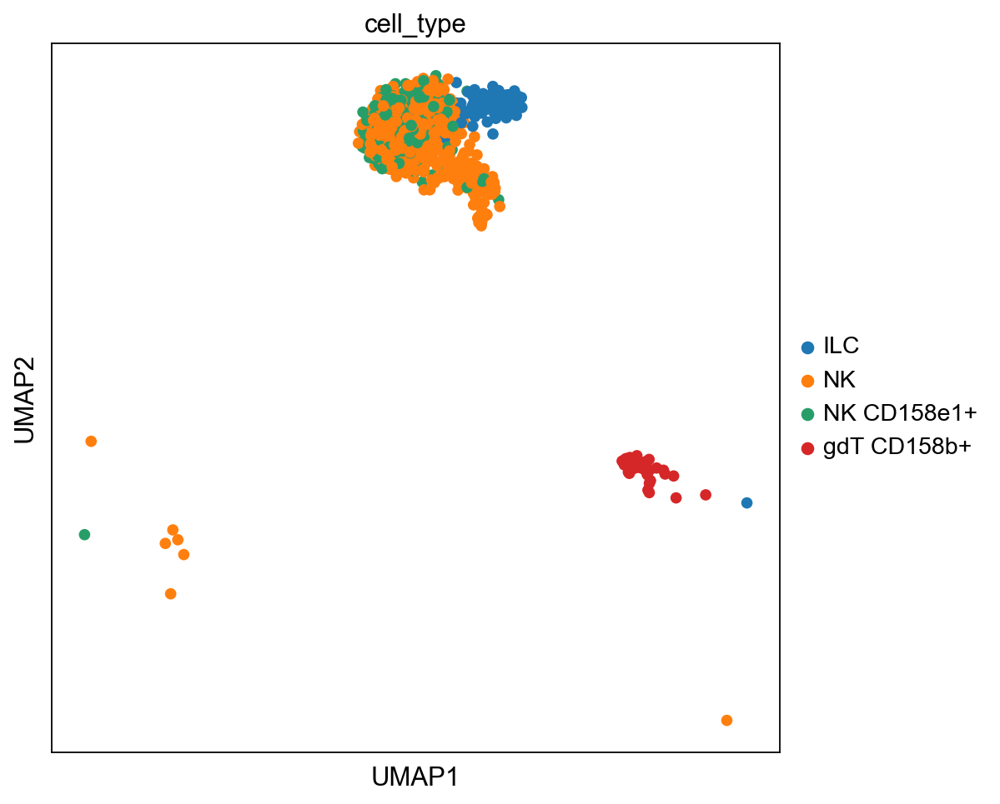

Immature NK cells, RNA


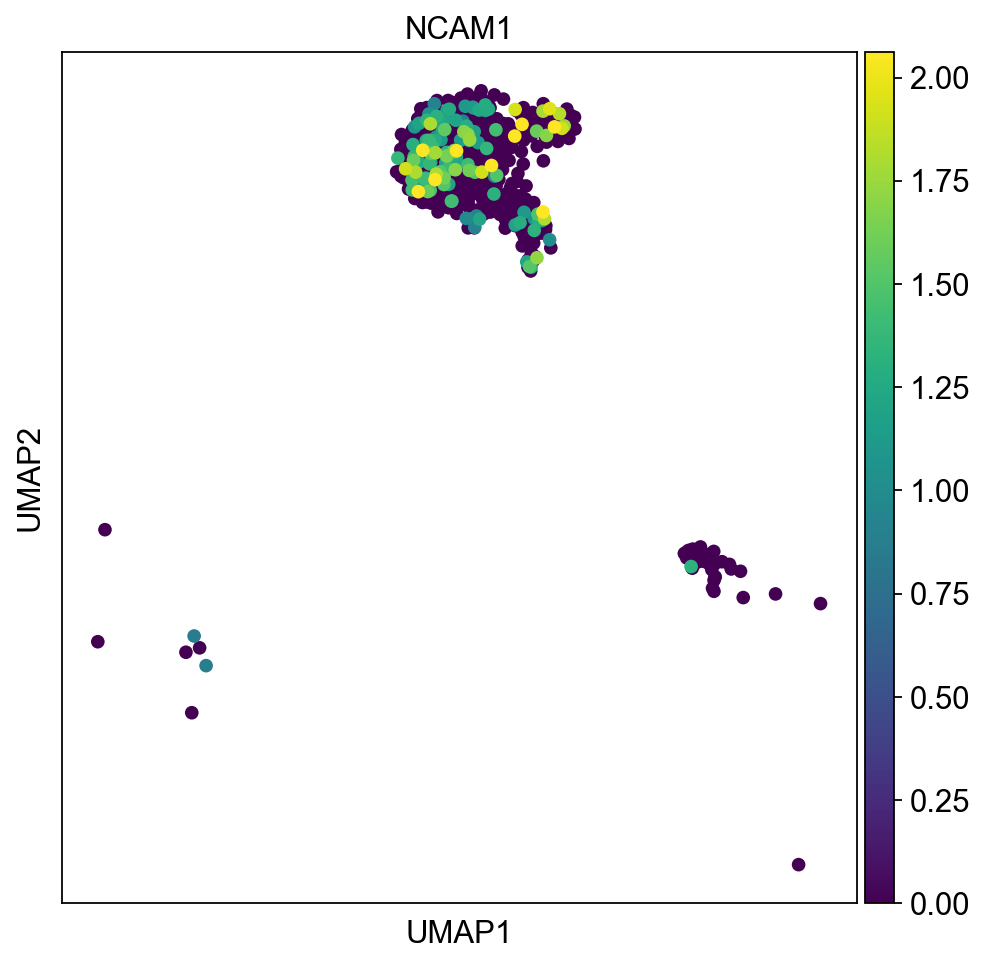

Immature NK cells, protein


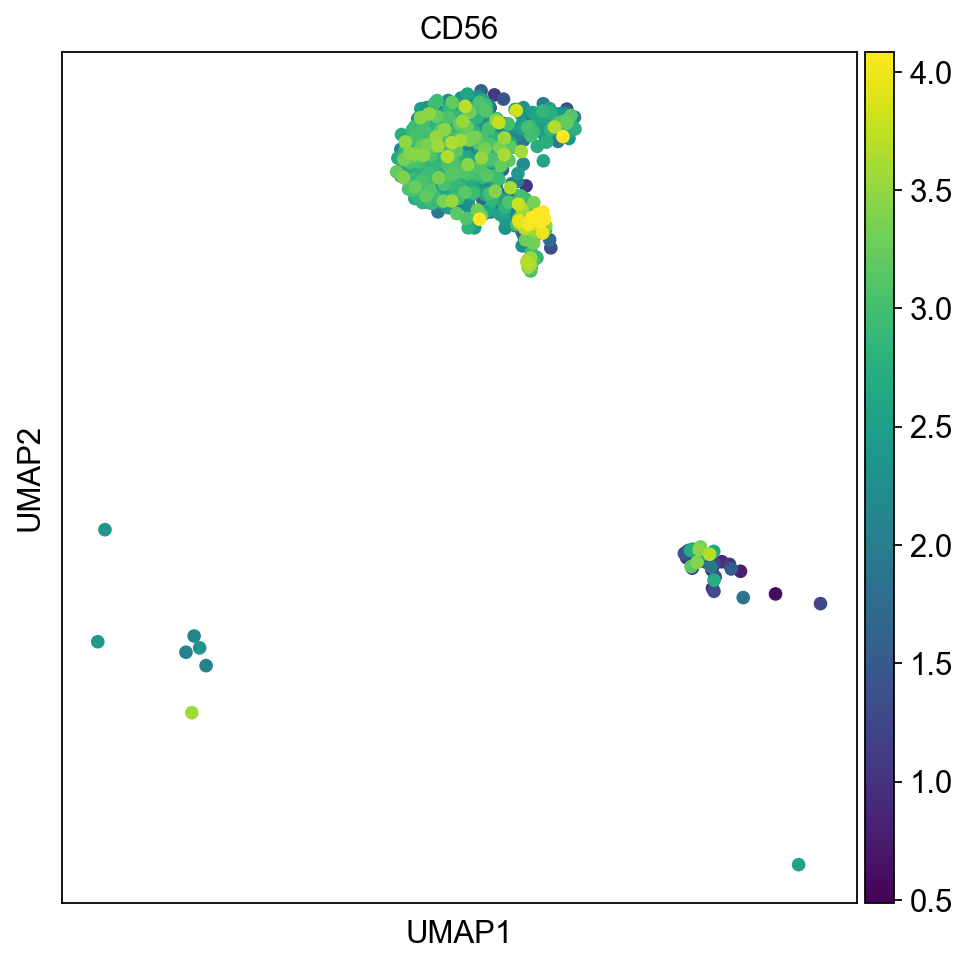

In [43]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Immature NK cells, RNA")
sc.pl.umap(sample_nk, color = nk_immature, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature NK cells, protein")
sc.pl.umap(sample_nk, color = nk_immature_prot, vmax="p99", color_map = 'viridis')

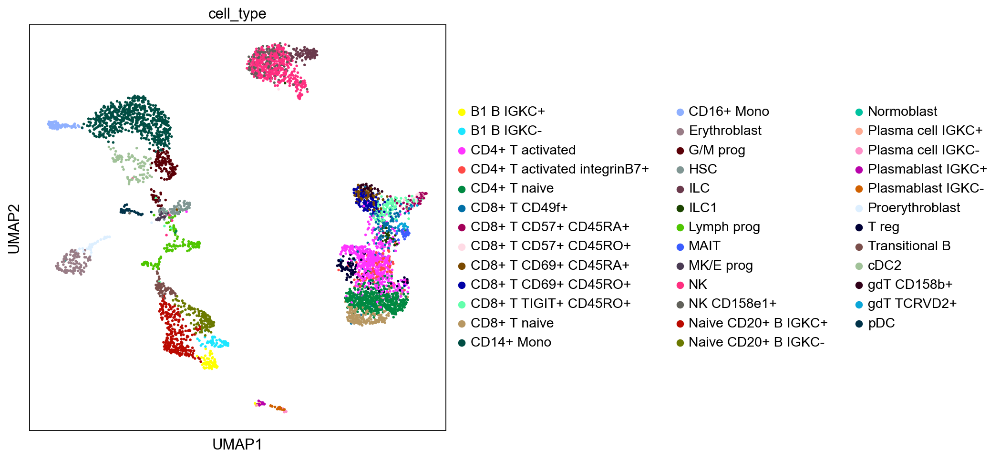

Immature NK cells, RNA


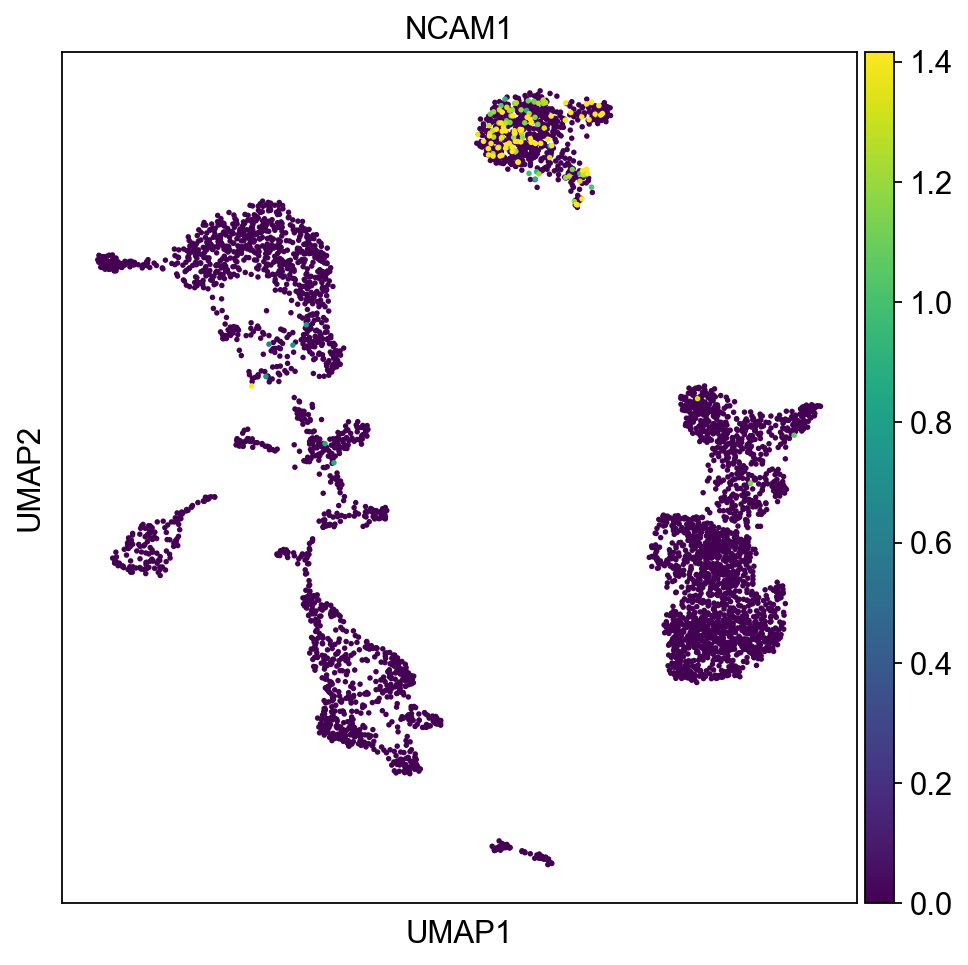

Immature NK cells, protein


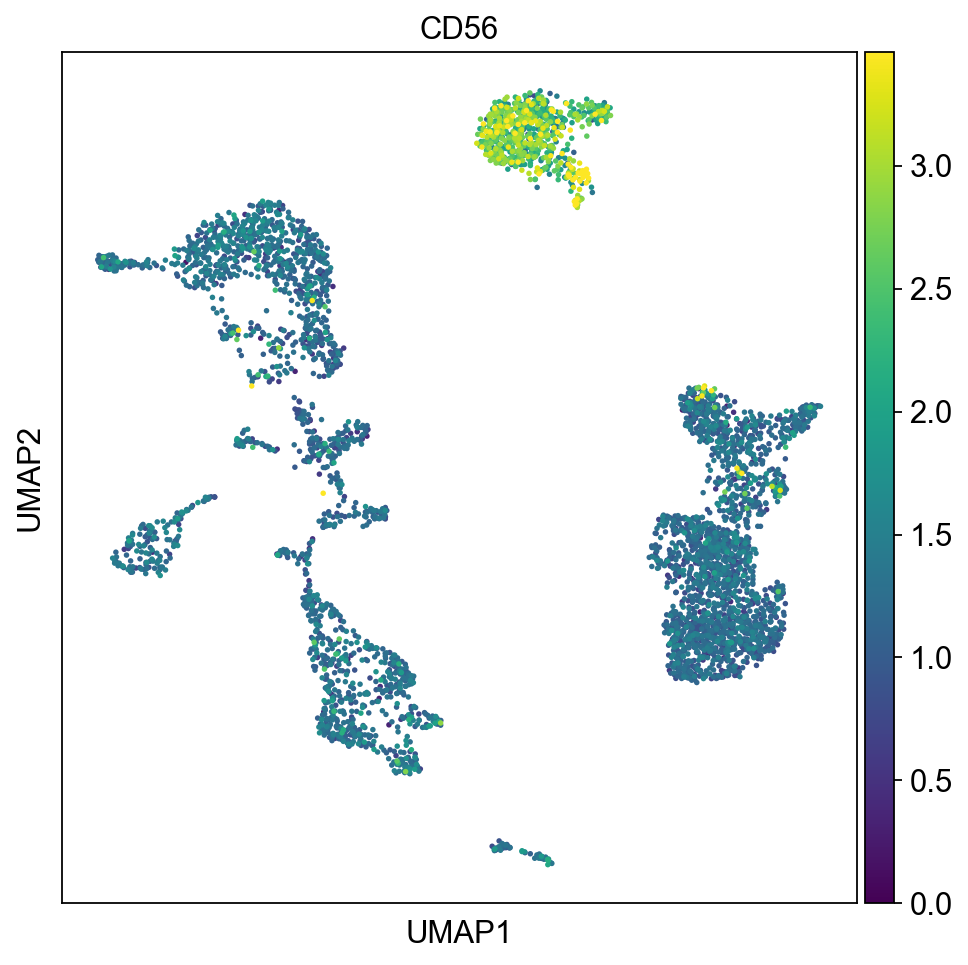

In [44]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Immature NK cells, RNA")
sc.pl.umap(eg, color = nk_immature, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature NK cells, protein")
sc.pl.umap(eg, color = nk_immature_prot, vmax="p99", color_map = 'viridis')

## Activating markers

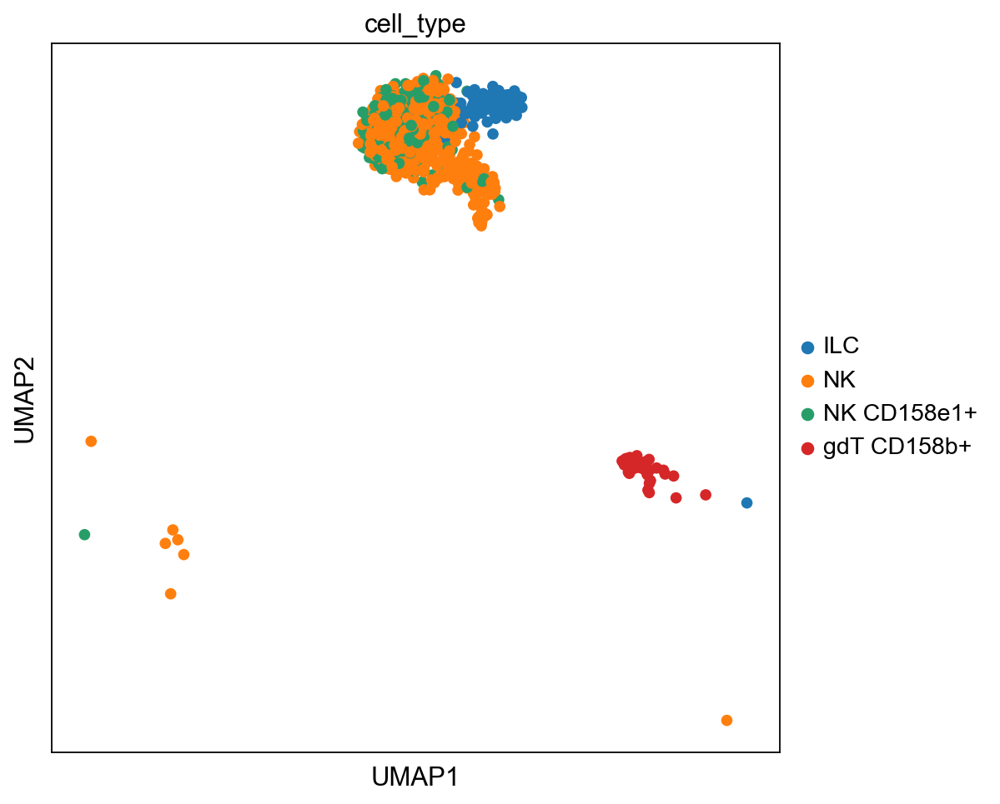

Is NK cell, RNA


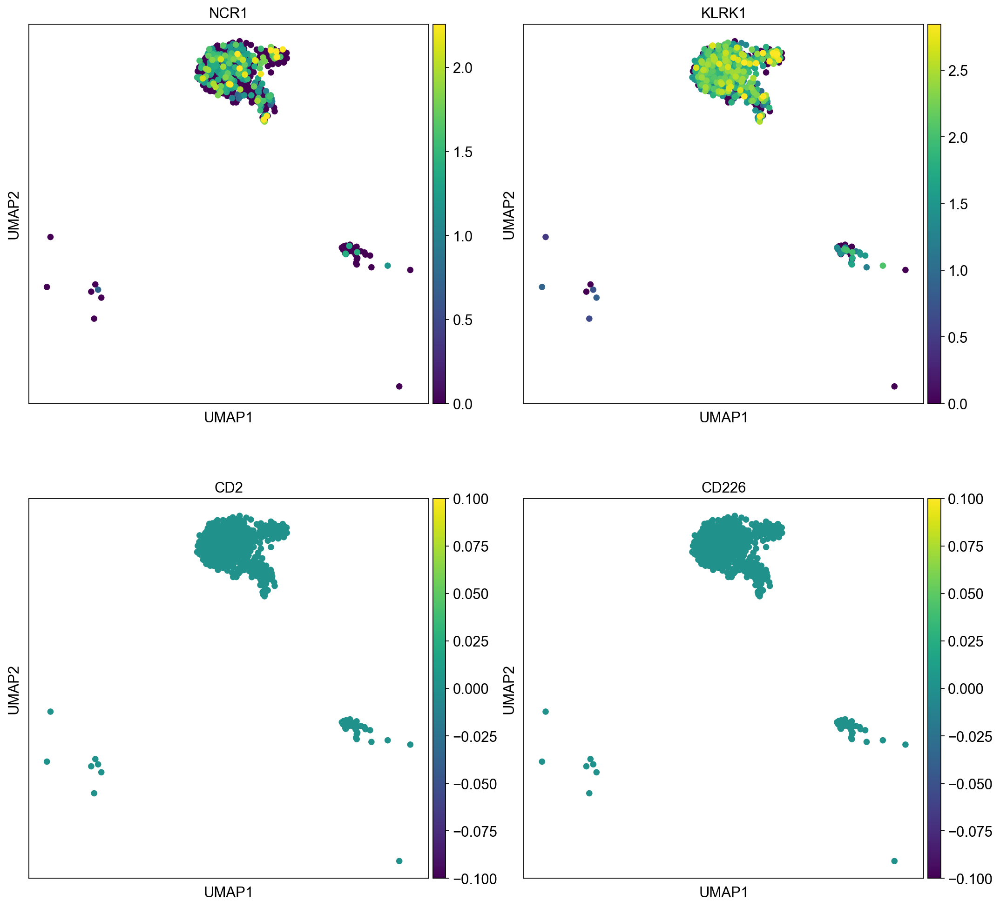

Is NK cell, protein (NCR1 = CD335, KLRK1 = CD314)


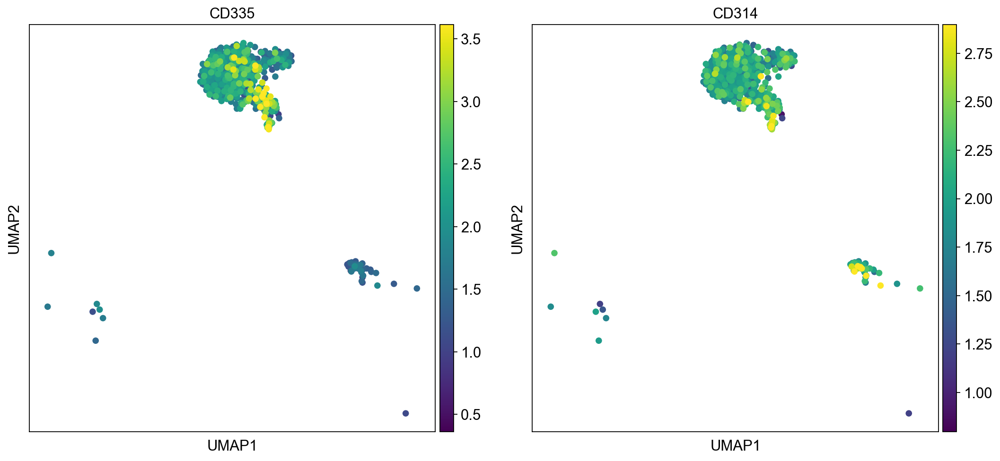

In [47]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, RNA")
sc.pl.umap(sample_nk, color = nk_activating, vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, protein (NCR1 = CD335, KLRK1 = CD314)")

sc.pl.umap(sample_nk, color = nk_activating_prot, vmax="p99", color_map = 'viridis', ncols =2 )

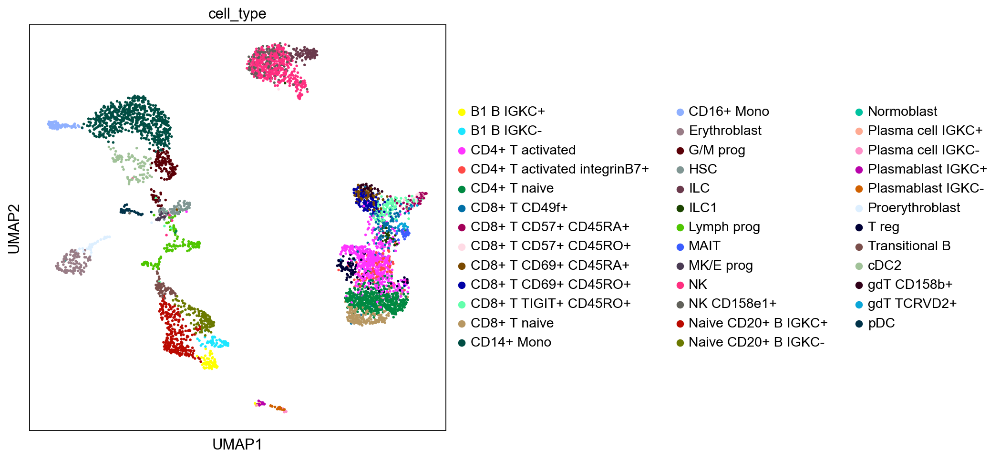

NK activating, RNA


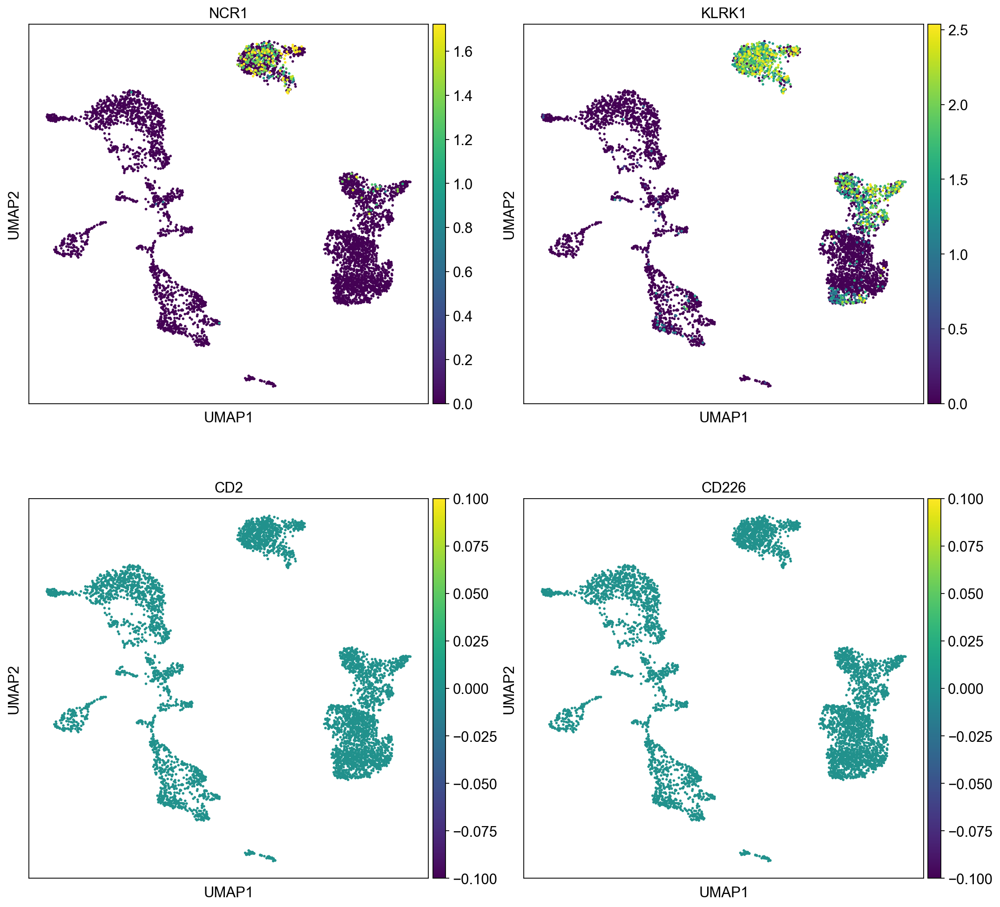

NK activating, protein (NCR1 = CD335, KLRK1 = CD314)


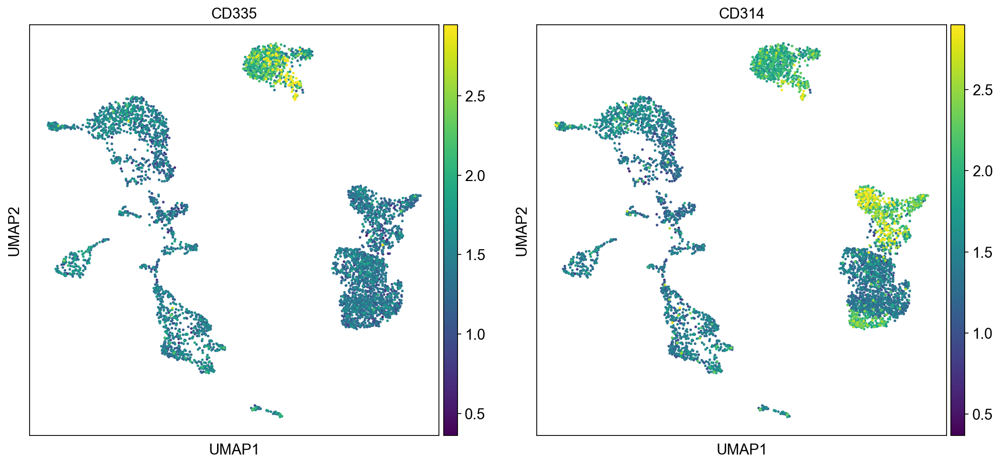

In [48]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("NK activating, RNA")
sc.pl.umap(eg, color = nk_activating, vmax="p99", color_map = 'viridis', ncols=2)

print("NK activating, protein (NCR1 = CD335, KLRK1 = CD314)")

sc.pl.umap(eg, color = nk_activating_prot, vmax="p99", color_map = 'viridis', ncols =2 )

## Maturation

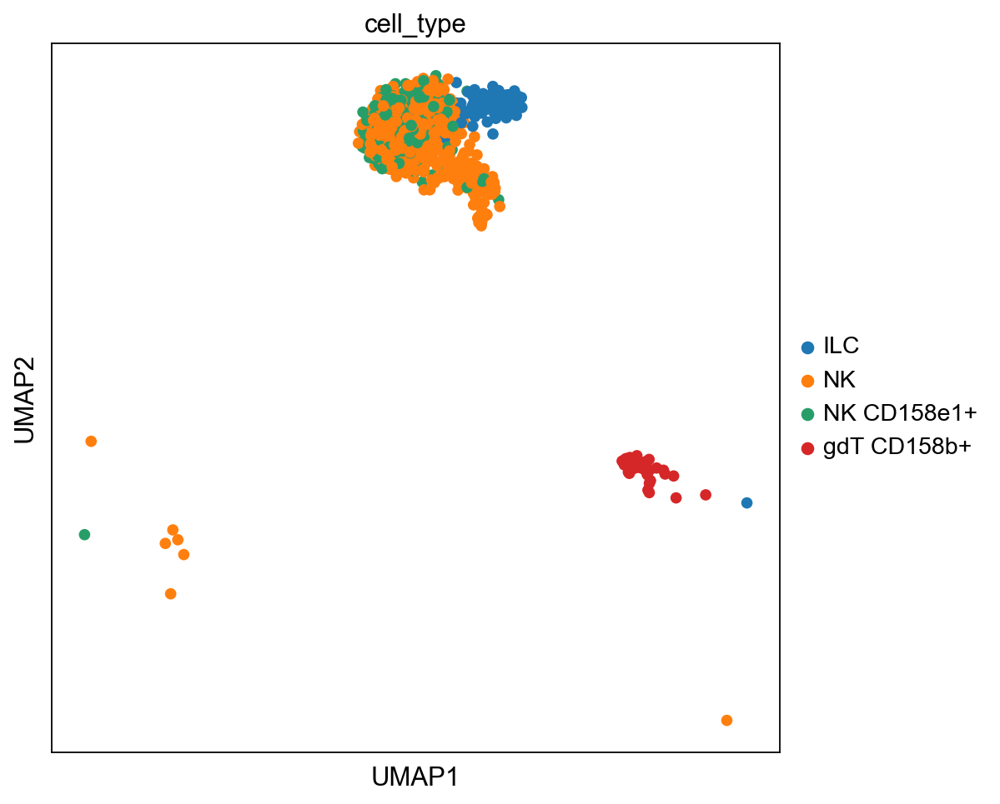

Mature NK cells, RNA


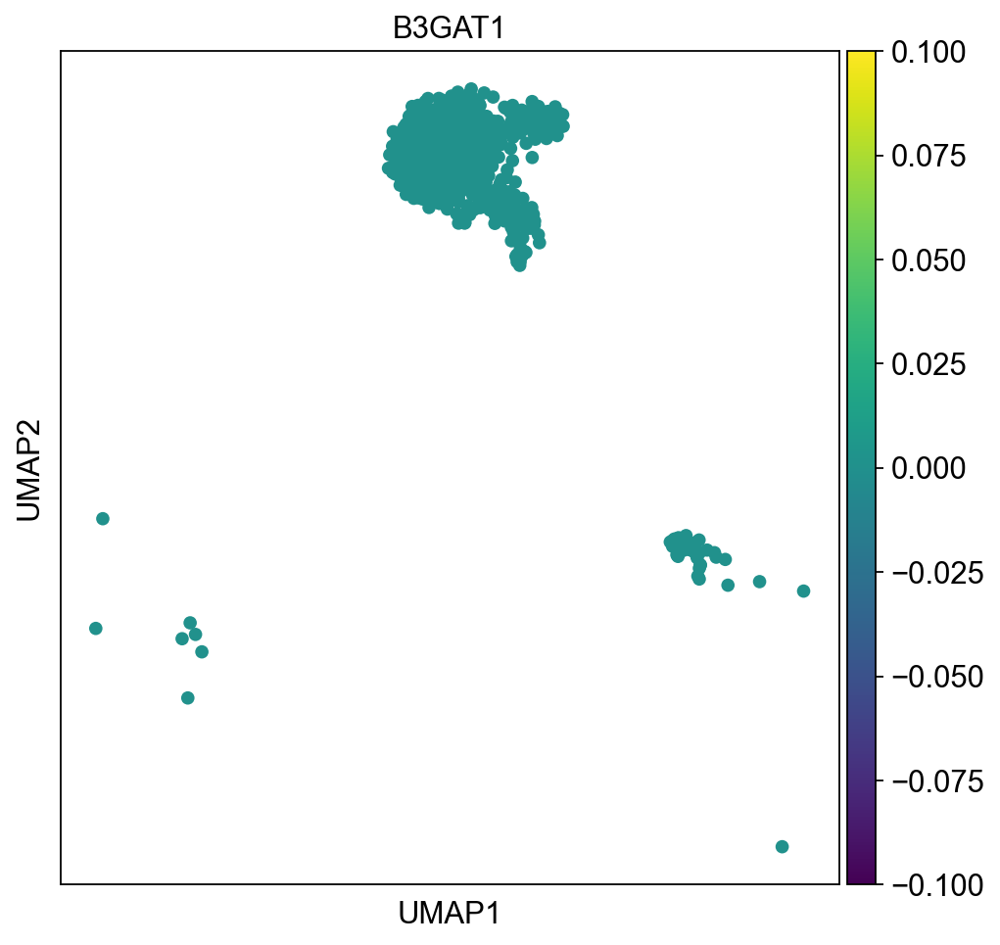

Mature NK cells, protein


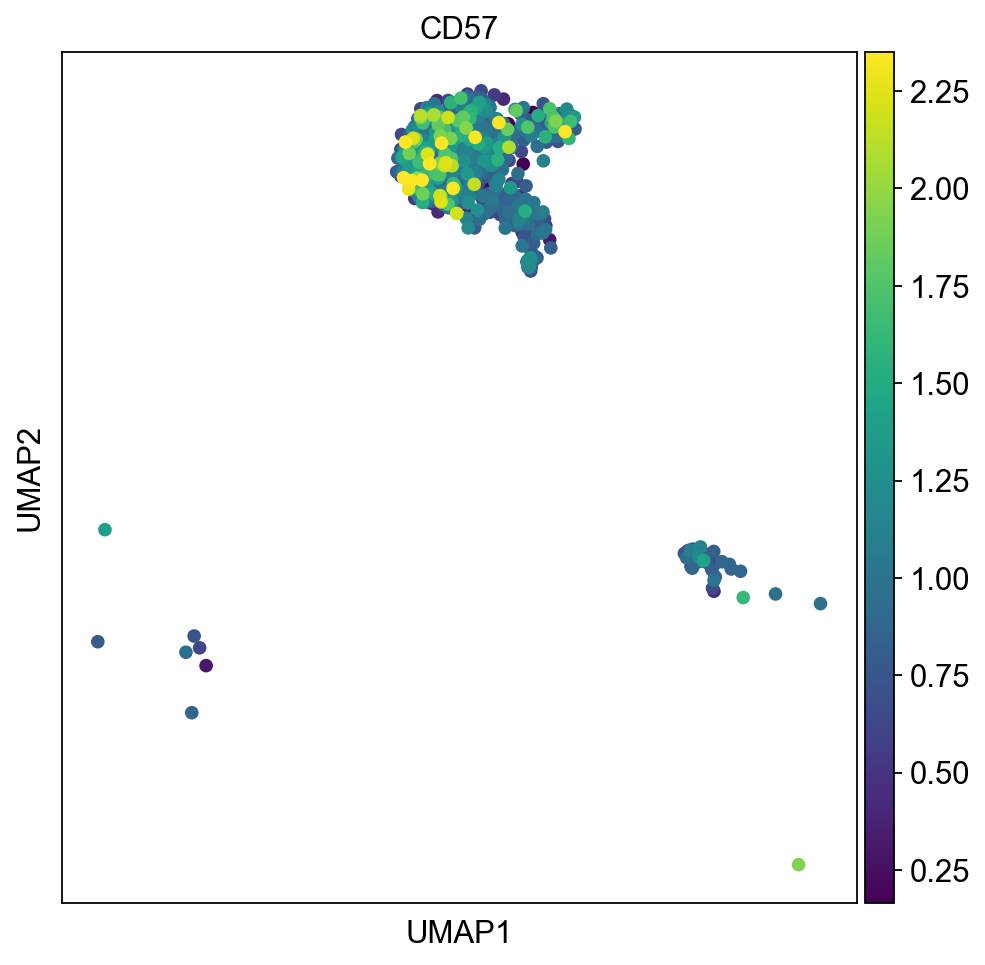

In [49]:
sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(sample_nk, color = nk_maturation, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, protein")
sc.pl.umap(sample_nk, color = nk_maturation_prot, vmax="p99", color_map = 'viridis', ncols=2)



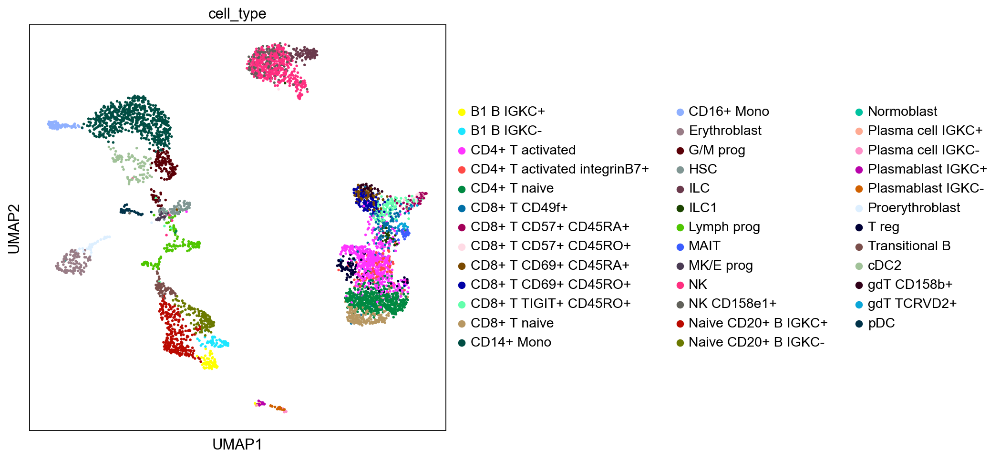

Mature NK cells, RNA


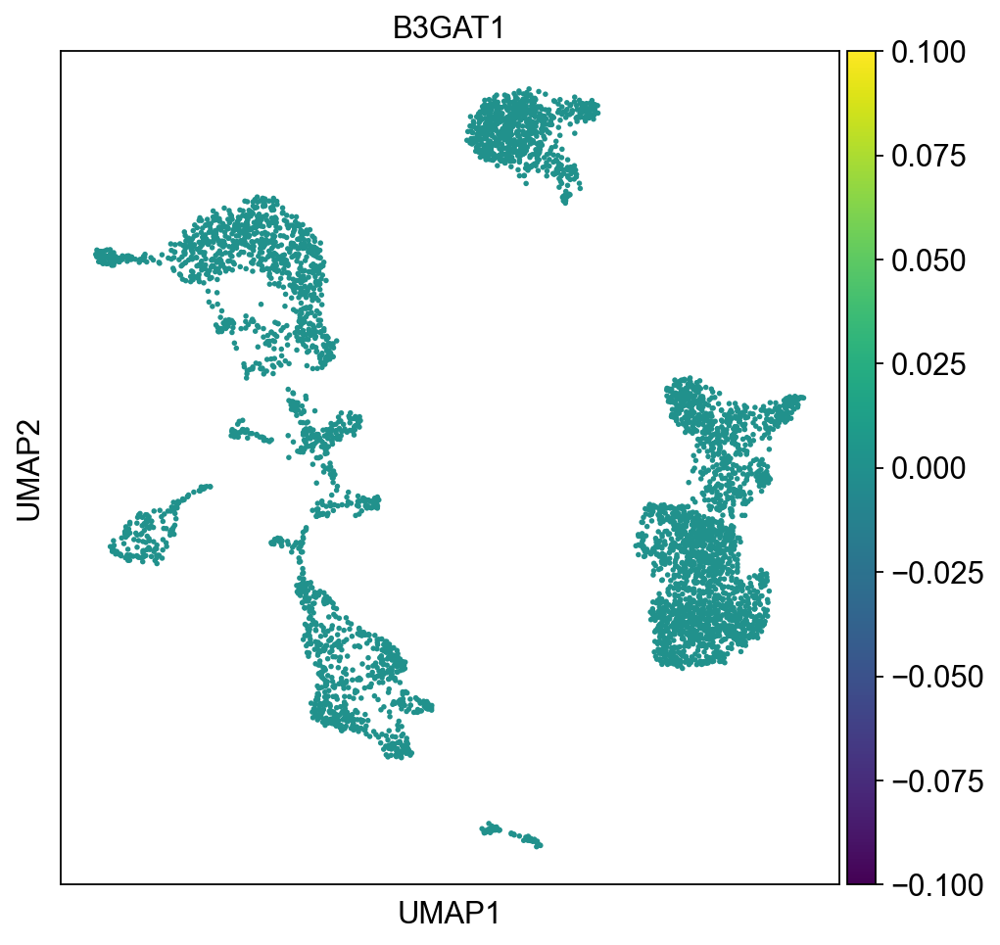

Mature NK cells, protein


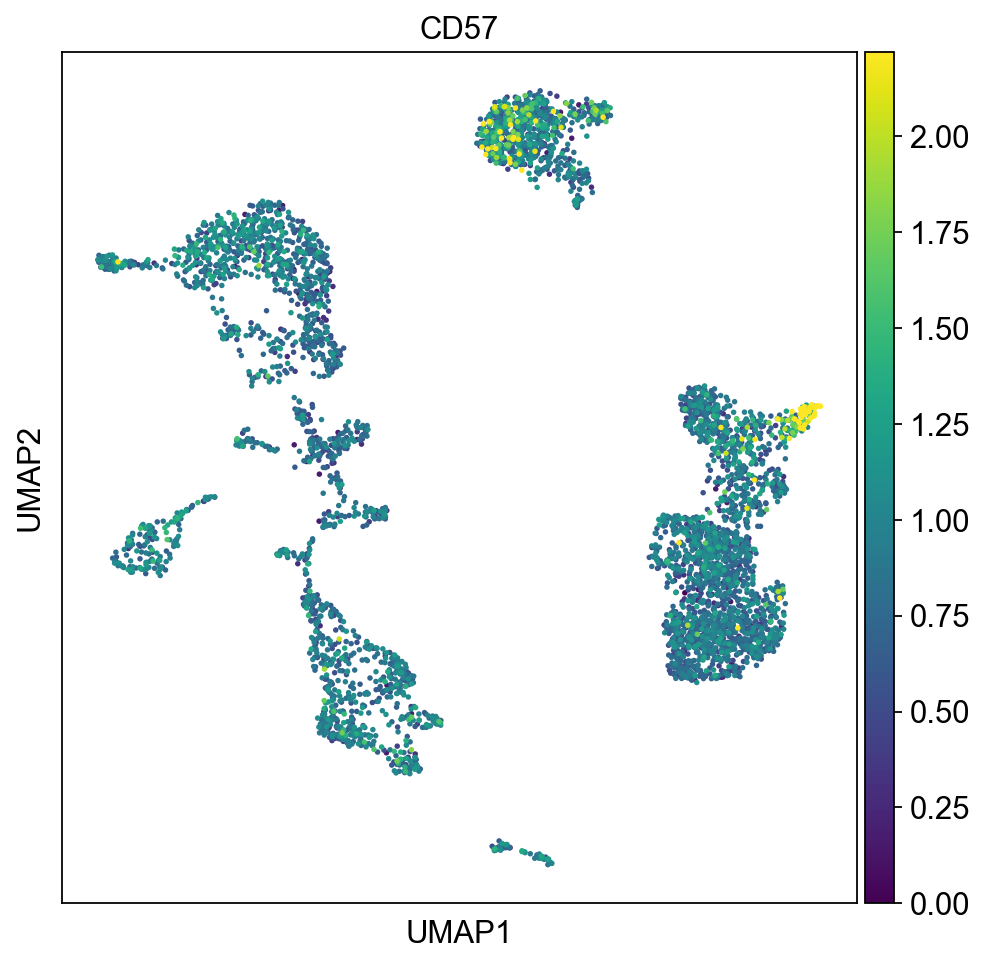

In [50]:
sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(eg, color = nk_maturation, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, protein")
sc.pl.umap(eg, color = nk_maturation_prot, vmax="p99", color_map = 'viridis', ncols=2)



## Inhibitory markers

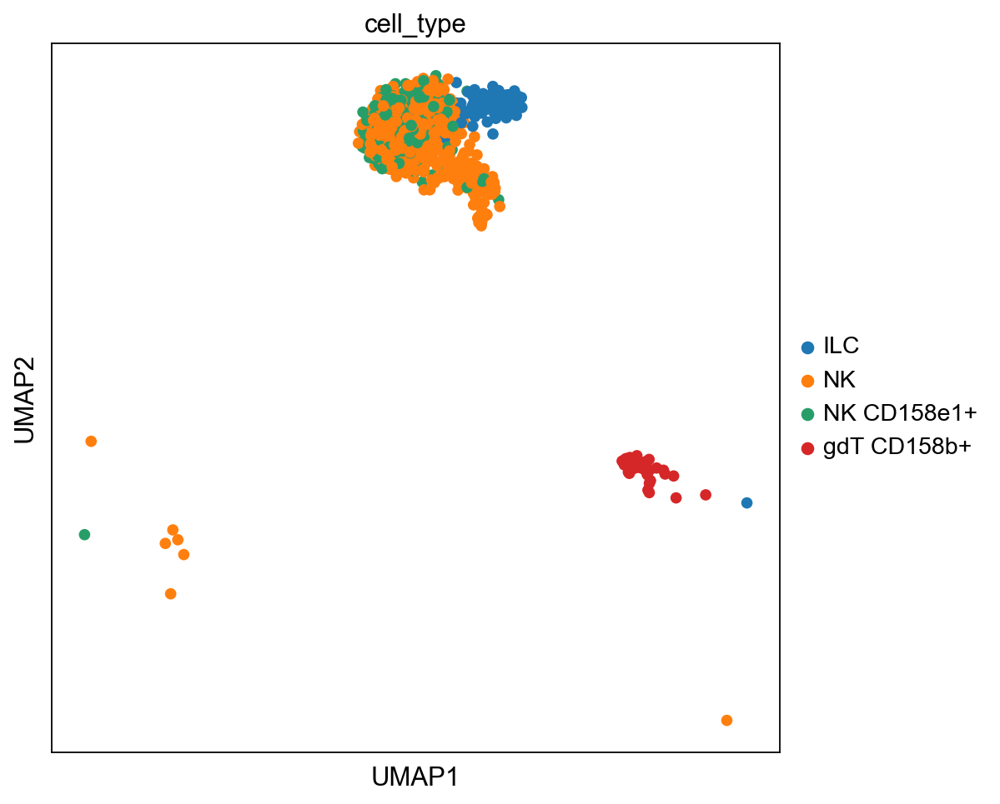

Inhibitory, RNA


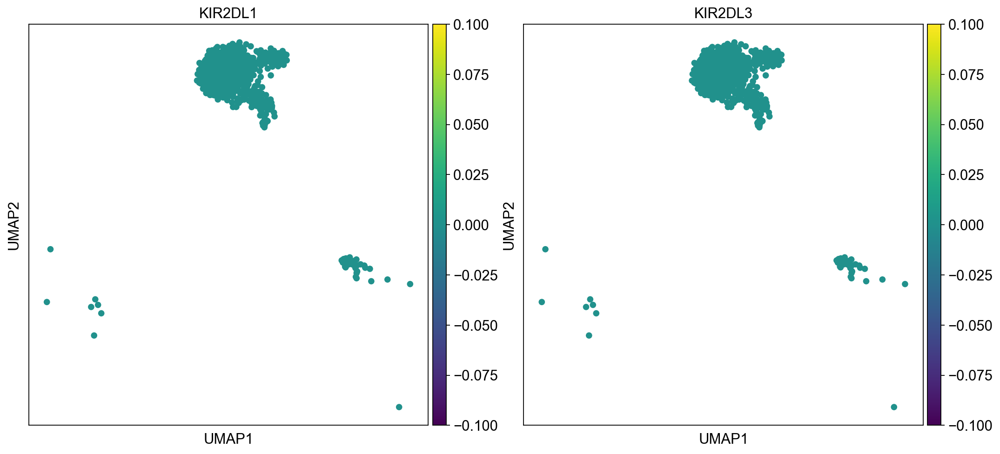

Inhibitory, protein, CD158e1 = KIR3DL1


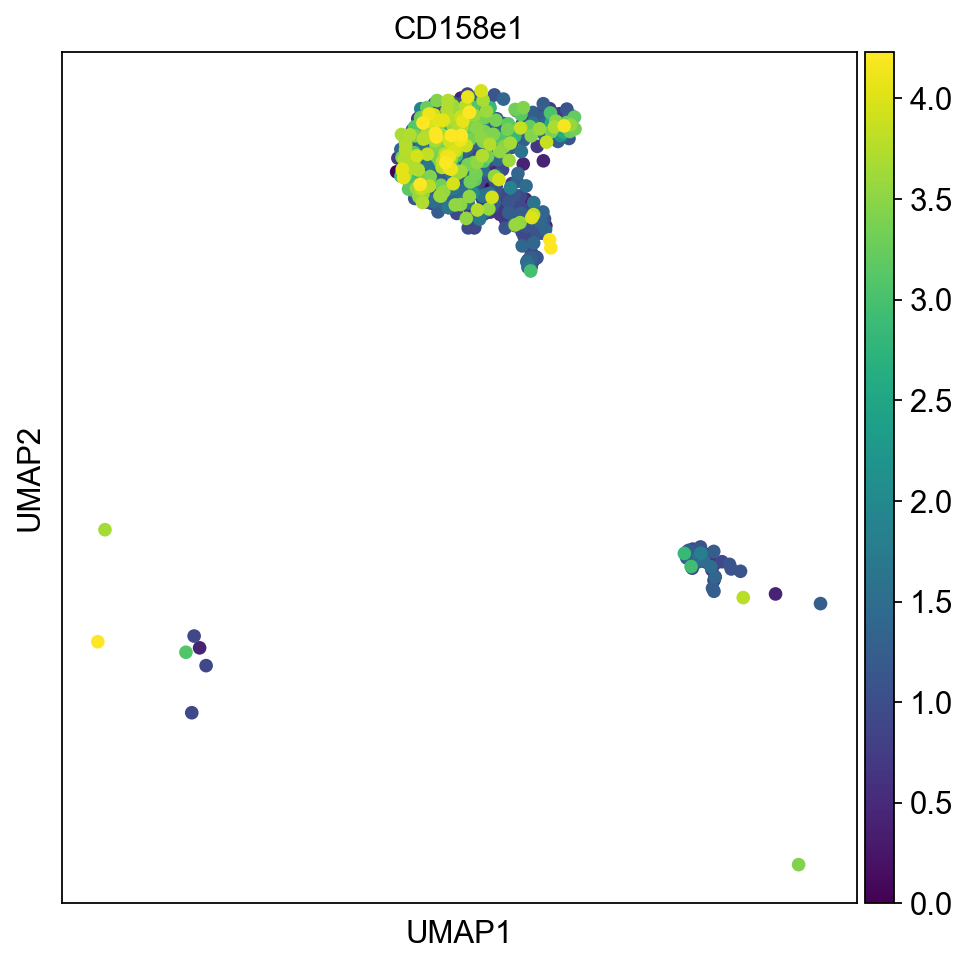

In [55]:

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inhibitory, RNA")
sc.pl.umap(sample_nk, color = nk_inhibitory, vmax="p99", color_map = 'viridis', ncols=2)

print("Inhibitory, protein, CD158e1 = KIR3DL1")
sc.pl.umap(sample_nk, color = nk_inhibitory_prot, vmax="p99", color_map = 'viridis', ncols=2)



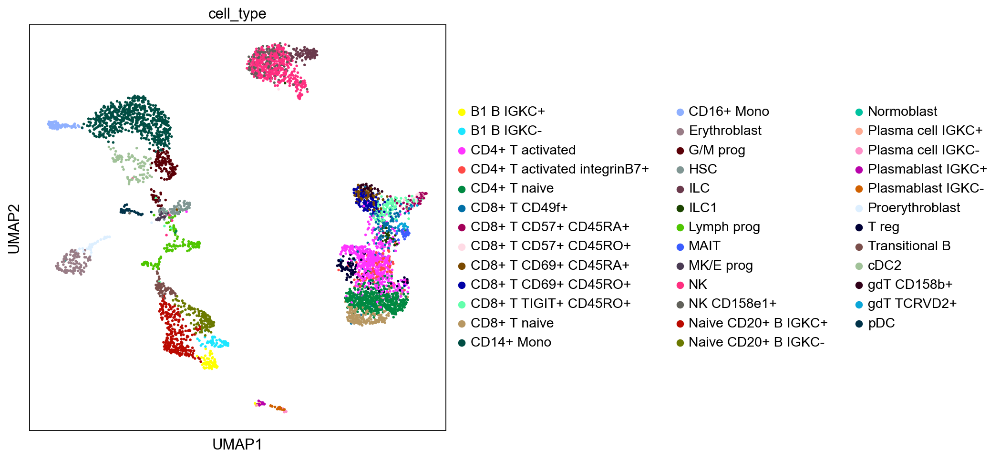

Inhibitory, RNA


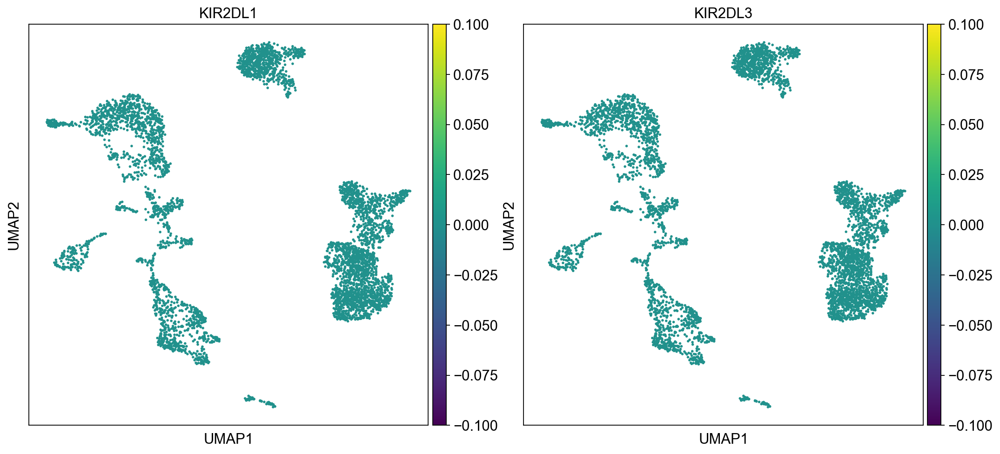

Inhibitory, protein


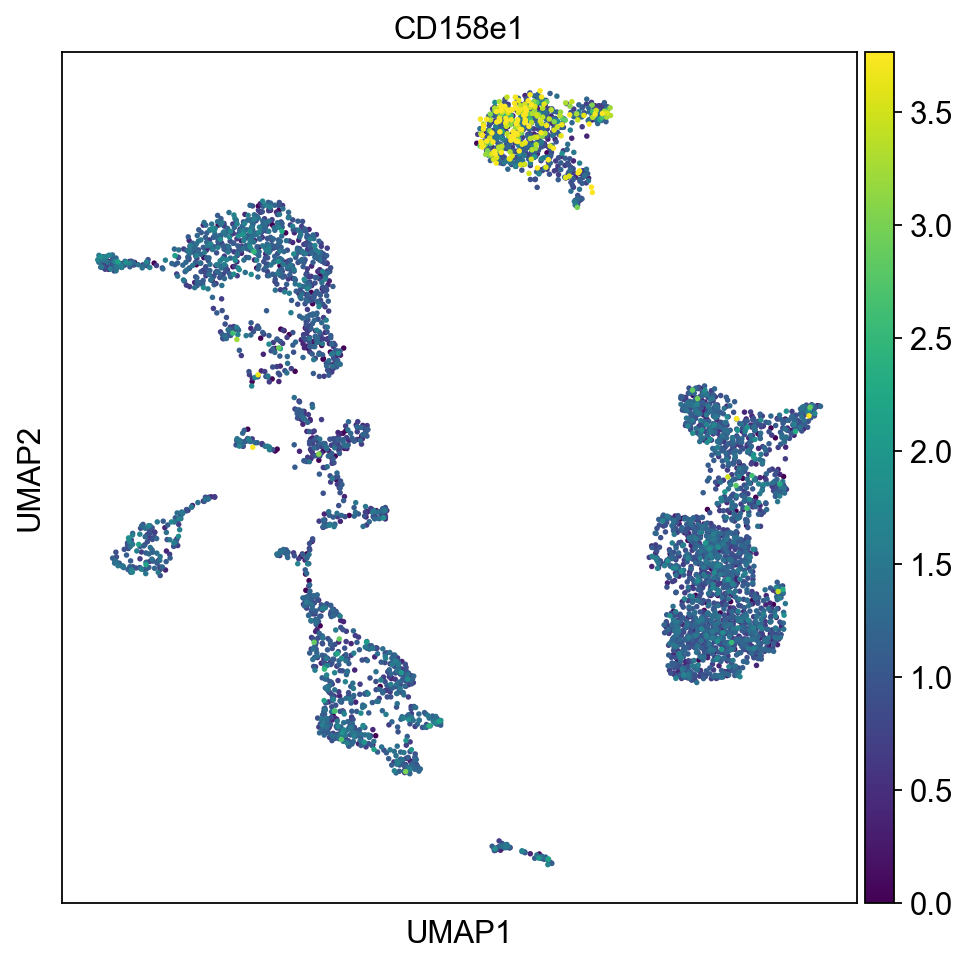

In [54]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inhibitory, RNA")
sc.pl.umap(eg, color = nk_inhibitory, vmax="p99", color_map = 'viridis', ncols=2)

print("Inhibitory, protein")
sc.pl.umap(eg, color = nk_inhibitory_prot, vmax="p99", color_map = 'viridis', ncols=2)



## Markers from R-code

In [68]:
nk_high_markers = ["FGFBP2", "FCGR3A", "S1PR5", "KLRC1", "KLRC2", "KLRC3", "KLRD1", "GNLY",
                     "GZMB", "CX3CR1", "GPR56", "PRF1", "KLRB1", "SPON2", "NKG7", "TTC38", "FCRL6", "LILRB1",
                     "PLAC8", "MBP"]
nk_genes2 = ["KLRC1","NCAM1","GZMK","GZMA","KLRB1","KLRC2","GZMH","LAG3","B2M","HLA-DRA","OAS3","MX1","IRF7","MX2","IRF9","OAS1","OAS2", "EIF2AK2", "TNFRSF18", "TNFRSF9",  "TNFRSF4",  "CRTAM", "ENTPD1",  "HAVCR2",  "TIGIT", "TNFSF10", "BCL2L11", "CCL3", "CCL4", "TNF", "IFNG", "CD69"]
nk_genes = ["CD3E", "NCAM1", "GZMK", "SELL", "XCL1", "XCL2", "KLRC1", "IL7R", "LTB", "FCGR3A", "GZMA", "GZMB", "GZMH", "GZMM", "KLRC2", "ZEB2", "KLF2", "PRDM1", "GZMH", "LAG3"]



#SG15 not measured

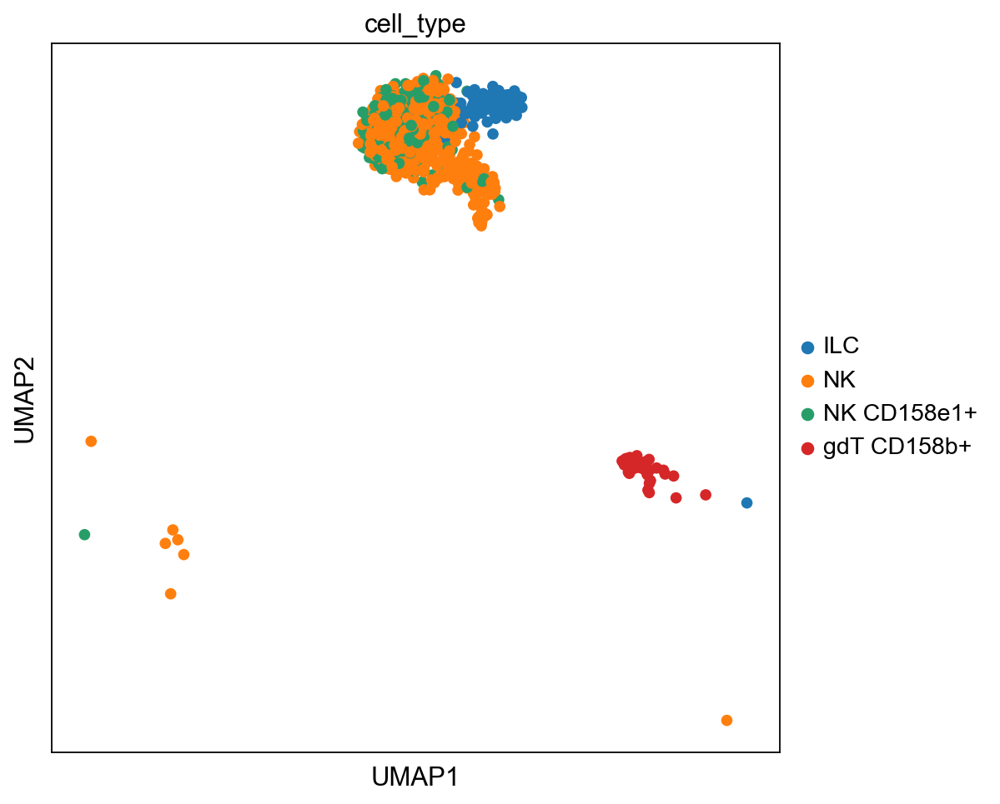

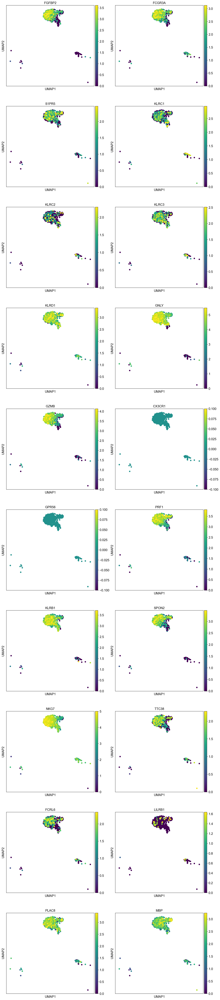

In [60]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = nk_high_markers, vmax="p99", color_map = 'viridis', ncols=2)




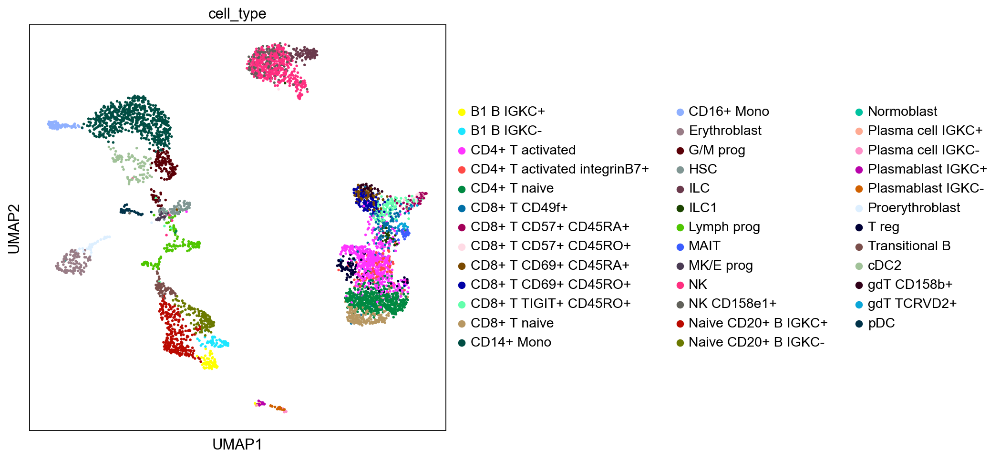

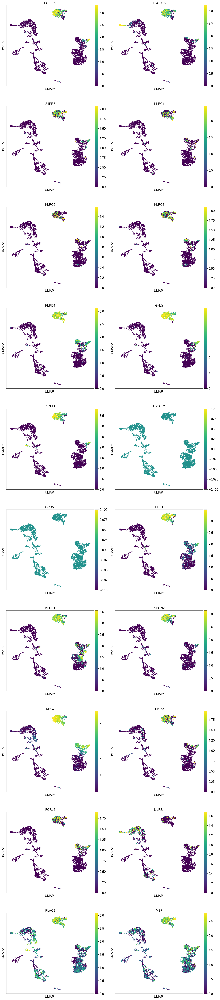

In [61]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = nk_high_markers, vmax="p99", color_map = 'viridis', ncols=2)



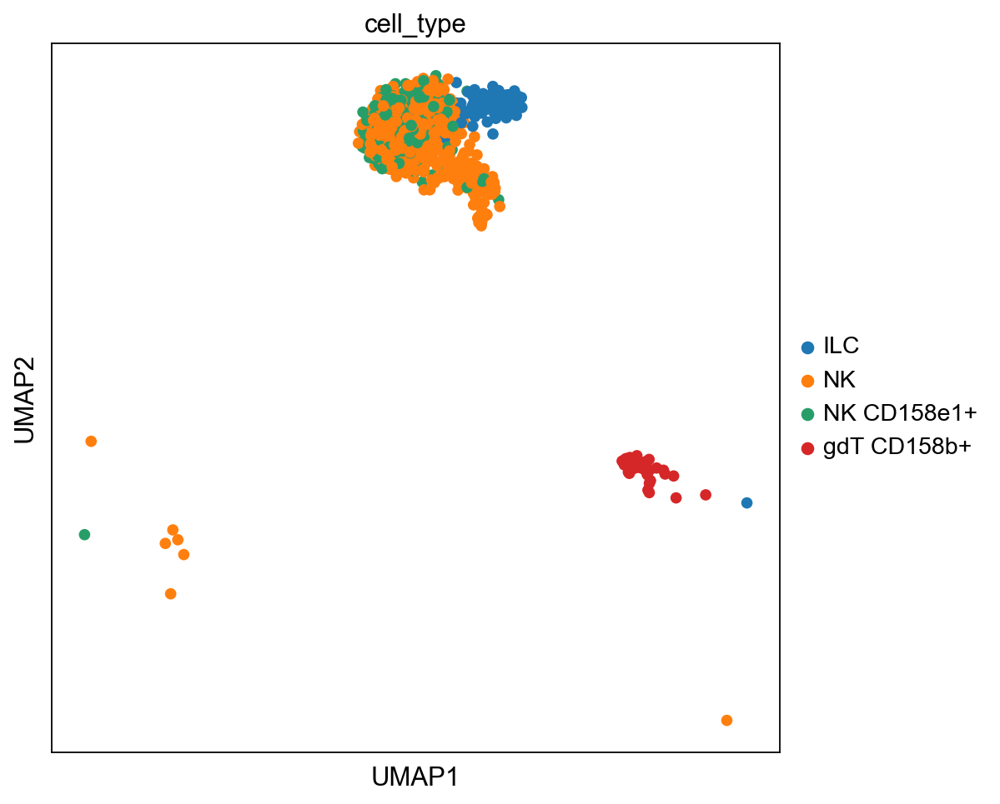

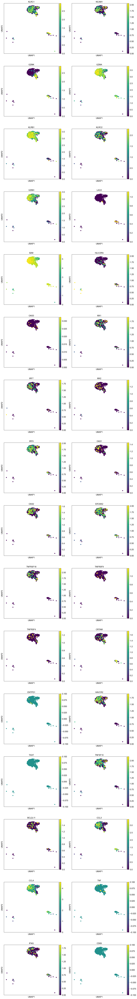

In [66]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = nk_genes2, vmax="p99", color_map = 'viridis', ncols=2)




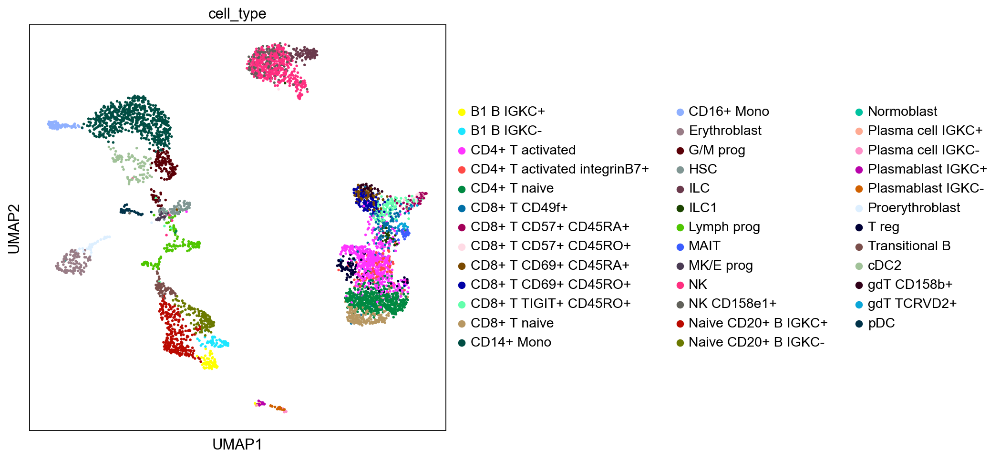

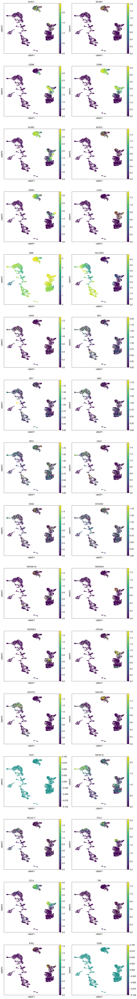

In [67]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = nk_genes2, vmax="p99", color_map = 'viridis', ncols=2)




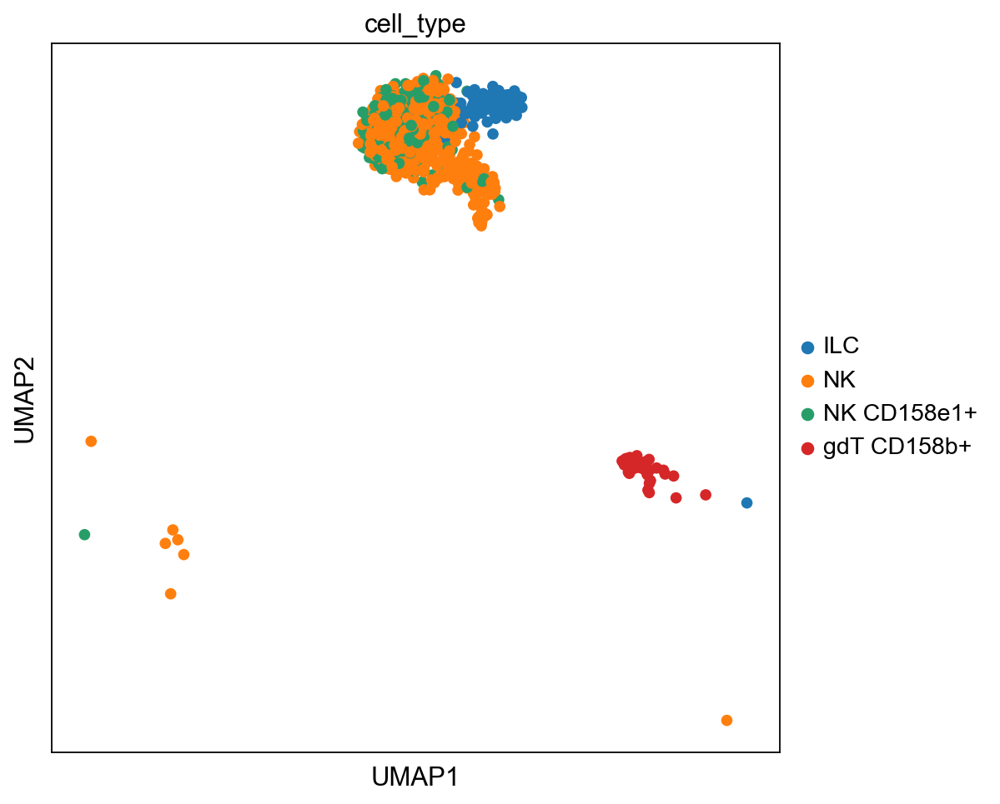

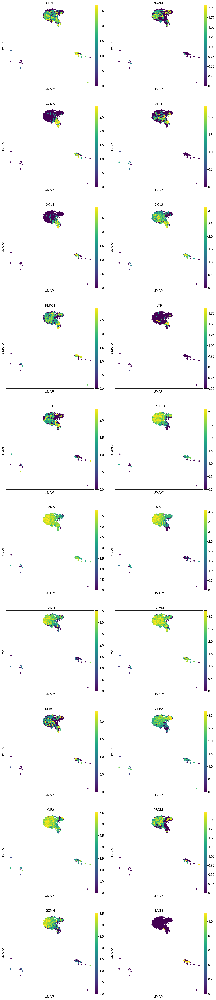

In [70]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = nk_genes, vmax="p99", color_map = 'viridis', ncols=2)




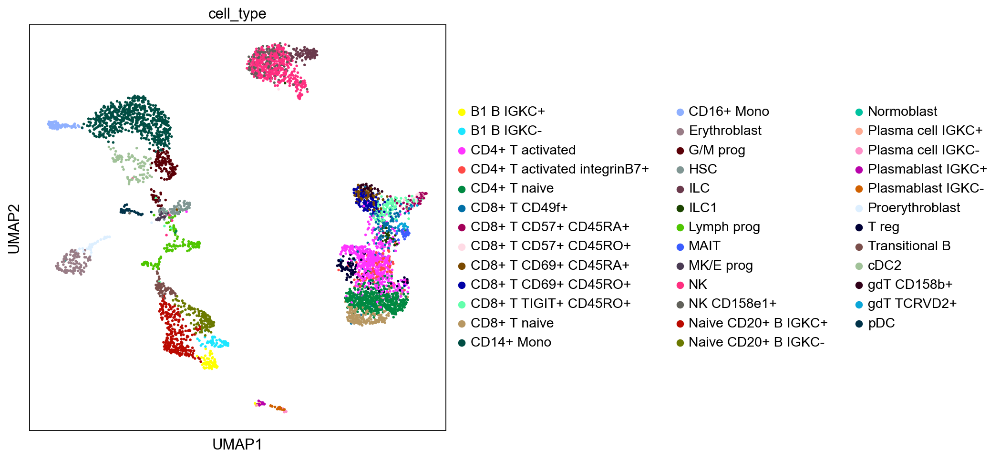

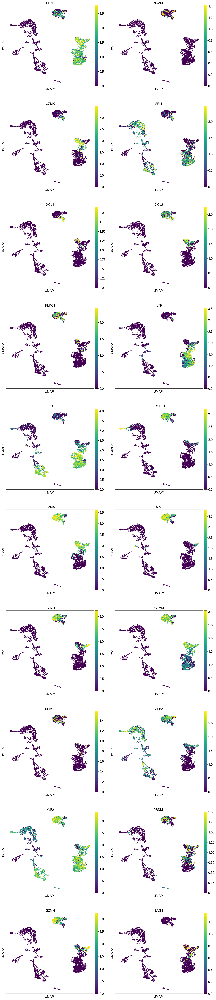

In [71]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = nk_genes, vmax="p99", color_map = 'viridis', ncols=2)


